# PYDECK library from python to generate MAP layers
- OCO2 and OCO3 datasets analysis on CALIFORNIA region only

In [11]:
# Libraries: 

import pydeck as pdk
import pandas as pd
import numpy as np
import netCDF4 as nc
import matplotlib.pyplot as plt

# WIDGETS
import ipywidgets as widgets

# LAYERS of pydeck operated:
* ScatterPlot Layer
* Column Layer

* EG: column layer, dataset 
    - https://github.com/ajduberstein/geo_datasets/blob/master/housing.csv

# Mapbox API
### Access token for mapbox REQUIRED on var 'MAP_API_KEY'

## Steps to generate API key for Map box;
* https://docs.mylistingtheme.com/article/how-to-generate-a-mapbox-api-key/

In [12]:
MAP_API_KEY= 'pk.eyJ1Ijoic2FnYXJsaW1idTAiLCJhIjoiY2t2MXhvd3lpNnFhZzJwdDlhbWU5emRyNSJ9.TlYL-IIZB9gEkX31muNvdQ'

#MAP_API_KEY= os.environ.get('YOUR PRIVATE_API_KEY')

In [13]:
print(MAP_API_KEY)

pk.eyJ1Ijoic2FnYXJsaW1idTAiLCJhIjoiY2t2MXhvd3lpNnFhZzJwdDlhbWU5emRyNSJ9.TlYL-IIZB9gEkX31muNvdQ


# OCO3-SIF

In [14]:
# oco3= nc.Dataset('./../../../Clusters_DATA_oil/OCO-3/SIF_files/2019/08/06/LtSIF/oco3_LtSIF_190806_B10206r_200709055238s.nc4')

In [15]:
# oco3.variables.keys()

# UPDATE: sif product -> Daily_SIF_757nm

In [16]:
# DATAFRAME
df_oco3= pd.read_csv('oco3_aug_2019.csv')

In [17]:
df_oco3['quality_flag'].unique()

array([2, 1, 0], dtype=int64)

In [18]:
df_oco3.head(3)

,quality_flag,sif,Latitude,Longitude
0,2,0.152224,-1.251343,98.627014
1,2,0.003326,-1.237305,98.618410
2,2,0.378100,-1.209717,98.601560


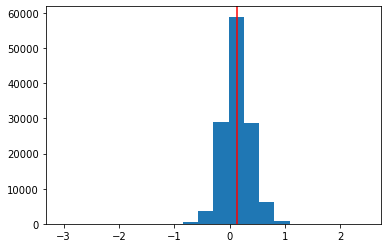

In [19]:
plt.hist( df_oco3['sif'], bins= 20)
plt.axvline(df_oco3['sif'].mean(), c='r');

# SIF: summary

In [20]:
df_oco3['sif'].describe()

count    127568.000000
mean          0.130890
std           0.243843
min          -3.043055
25%          -0.023389
50%           0.115132
75%           0.280318
max           2.457429
Name: sif, dtype: float64

# OCO2-XCO2
* data products used: XCO2, Latitude, Longitude, quality_flag

# Converting to JSON file:
- Requirement for Scatterplot layers: READS only json format

In [21]:
# df_oco2['coordinates']= coordinates
# df_oco2.to_json('oco2_json_file.json')

In [22]:
df_oco2_json= pd.read_json('cali_json_oco2.json')
df_oco2_json.head(3)

,Xco2,Latitude,Longitude,quality_flag,DateTime,Year,Month,Day,Date,coordinates
0,410.63538,37.332195,-118.030570,0,2019-01-01 20:49:10.010,2019,1,1,2019-01-01 20:49:10.010,"[-118.03057, 37.332195]"
1,410.01233,37.336678,-118.024770,0,2019-01-01 20:49:10.320,2019,1,1,2019-01-01 20:49:10.320,"[-118.02477, 37.336678]"
2,410.22345,37.354710,-118.031654,0,2019-01-01 20:49:10.720,2019,1,1,2019-01-01 20:49:10.720,"[-118.031654, 37.35471]"


In [23]:
df_oco2_json['coordinates']

0         [-118.03057, 37.332195]
1         [-118.02477, 37.336678]
2         [-118.031654, 37.35471]
3        [-118.025856, 37.359116]
4         [-118.01324, 37.345264]
                   ...           
74202     [-118.15063, 34.148277]
74203     [-118.78087, 40.408886]
74204      [-118.87865, 40.72831]
74205    [-118.900665, 41.076202]
74206     [-118.93843, 41.103096]
Name: coordinates, Length: 74207, dtype: object

# Setup: View State

In [24]:
view= pdk.data_utils.compute_view(df_oco2_json[["Longitude","Latitude"]])
# view= pdk.ViewState(latitude= 32.80, longitude= -97, pitch= 50, zoom =1)

In [25]:
# # View
view.pitch= 55
view.bearing= 30
view.zoom= 2

### Widgets: (bottom section)
* creating a slider that moves the data points by month

In [26]:
df_oco3.head(3)

,quality_flag,sif,Latitude,Longitude
0,2,0.152224,-1.251343,98.627014
1,2,0.003326,-1.237305,98.618410
2,2,0.378100,-1.209717,98.601560


In [27]:
# function
# STEPS: different color for each values (0, 1 ,2)
def my_color(x):
    #return (lambda u:u *2)(x)
    return ((lambda j: 10 if j== 0 else(20 if j==1 else 30))(x))

In [28]:
my_color(0), my_color(1), my_color(2), my_color(29)

(10, 20, 30, 30)

In [29]:
# TEST: COLOR ranges for each data product

color_list= df_oco3["quality_flag"].apply(my_color)

# new col
df_oco3['color']= color_list

In [30]:
print(df_oco3['quality_flag'].apply(my_color))

0         30
1         30
2         30
3         30
4         30
          ..
127563    10
127564    10
127565    10
127566    10
127567    10
Name: quality_flag, Length: 127568, dtype: int64


In [31]:
df_oco3.head(4)

,quality_flag,sif,Latitude,Longitude,color
0,2,0.152224,-1.251343,98.627014,30
1,2,0.003326,-1.237305,98.618410,30
2,2,0.378100,-1.209717,98.601560,30
3,2,0.496295,-1.248413,98.647220,30


In [32]:
df_oco3['quality_flag'].unique()

array([2, 1, 0], dtype=int64)

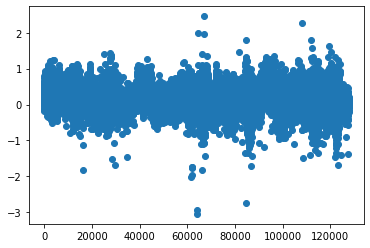

In [33]:
plt.scatter( np.arange(0, len(df_oco3['sif'])), df_oco3['sif'])

In [34]:
# Layer
scatterPlot_layer= pdk.Layer(
    #"ColumnLayer",
    "ScatterplotLayer",
#    "PathLayer",
#    "ArcLayer",
    data= df_oco2_json,  
    opacity= 0.8,
    stroked= True,
    filled= True,
    radius_scale= 10,
    radius_min_pixels= 2,
    radius_max_pixels= 100,
    line_width_min_pixels= 1,

    get_position= "coordinates",

    get_fill_color=[55, 165,0,180],
    
    # data points color
    get_line_color=[0,0,0]
)


tooltip_a={
    "html": "<b>SIF_757nm=> {sif}</b>",
#    "html": "<b>quality=> {quality_flag}</b>",
    "style": {"background": "grey", "color":"black", "font-family":"Arial"}
}

tooltip_b={
 #   "html": "<b>SIF_757nm=> {sif}</b>",
    "html": "<b>quality=> {quality_flag}</b>",
    "style": {"background": "grey", "color":"black", "font-family":"Arial"}
}


# COLUMN Layer
# OCO3= SIF column
column_layer= pdk.Layer(
    "ColumnLayer",
    data= df_oco3,
    get_position=["Longitude","Latitude"],
    get_elevation="sif",
    elevation_scale=10000,
    
    # Hover data
    pickable= True,
    #highlights the COLUMN
    auto_highlight= True,
#    get_fill_color= [255, 300]

#    get_fill_color= ["quality_flag","quality_flag * 100"],

#    get_fill_color= ['"'+ df_oco3["quality_flag"].apply(my_color)+'"']
    get_fill_color= ["color *10", "color *100", 140]
)



# DECK
r= pdk.Deck(
    layers=[scatterPlot_layer, column_layer],
    #layers=[scatterPlot_layer],
    initial_view_state=view,
    map_provider="mapbox",
#    map_style= pdk.map_styles.SATELLITE,
    map_style= 'mapbox://styles/mapbox/light-v10',
    mapbox_key= MAP_API_KEY,
    # data point hover info
    tooltip= [tooltip_a, tooltip_b]

)

#Widgets
slider= widgets.IntSlider(value= 1, min= 1, max= 12, step = 1)
play= widgets.Play(value= 1, min= 1, max= 12, step= 1, description= 'Months',
                  interval= 1_000)
widgets.jslink((play, 'value'), (slider, 'value'))
layout= widgets.HBox([slider, play])


# function: that passes slider to change MONTHS
def update_plot(Month):
    # pass the data from JSON file
    scatterPlot_layer.data= df_oco2_json[df_oco2_json['Month'] == Month]
    return r.update()

# creating an interaction with widgets
#interact= widgets.interactive_output(update_plot, {'Month': slider});

interact= widgets.interactive_output(update_plot, {'Month': slider});
display(layout, interact)


# display and update the map layer

r.to_html("xco2_column_layer.html")

Output()

# OCO2-> XCO2 only

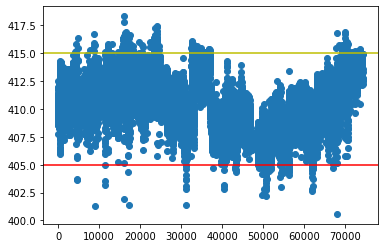

In [35]:
plt.scatter(np.arange(0, len(df_oco2_json["Xco2"])), df_oco2_json["Xco2"])
plt.axhline(405, c='r')
plt.axhline(415, c='y')

In [36]:
# Xco2 Color range FOR california region has XCO2 range from 400- 417
# Ranges: 395-405, 400-410, 410-420, 420> 

def xco2_color(c):
    
#     if ((c> 400.00) & (c < 405.00)):
#         return [10, 230, 120]
    
#     elif((c> 405.00) & (c < 410.00)):
#         return [20, 200, 160]
     #elif (c> 415.00) & (c < 420.00):
    r= np.arange(400,410)
    
    if (c < 405.00):
        #return [10, 230, 120]
        return [255, 215, 0]
    
    elif((c > 405.00) & (c < 410.00)):
        return [0, 201, 87]
    
    elif((c > 410.00) & (c < 415.00)):
        #return [200, 100, 20]
        return [255,215,0]

    elif(c>415):
        # red
        return [255,48,48]
    #return [230, 158, 10]

In [37]:
df_oco2_json['xco2_color']= df_oco2_json['Xco2'].apply(xco2_color)

In [38]:
# df_oco2_json[df_oco2_json["Xco2"]> 410]
#df_oco2_json["xco2_color"]

# df_oco2_json.tail(3)

In [39]:
# Layer
scatterPlot_layer= pdk.Layer(
    #"ColumnLayer",
    "ScatterplotLayer",
#    "PathLayer",
#    "ArcLayer",
    data= df_oco2_json,  
    opacity= 0.8,
    stroked= True,
    filled= True,
    radius_scale= 30,
    radius_min_pixels= 2,
    radius_max_pixels= 100,
    line_width_min_pixels= 1,

    get_position= "coordinates",

    get_fill_color= "xco2_color",
    # hover
    pickable= True
    #get_fill_color=[55, 165,0,180],
   # get_fill_color= ["Xco2","Xco2 *100"],
    # data points color
   # get_line_color=["Xco2"]
    
)


tooltip_a={
    "html": "<b>XCO2 => {Xco2}</b>",
#    "html": "<b>quality=> {quality_flag}</b>",
    "style": {"background": "grey", "color":"black", "font-family":"Arial"}
}

# tooltip_b={
#  #   "html": "<b>SIF_757nm=> {sif}</b>",
#     "html": "<b>quality=> {quality_flag}</b>",
#     "style": {"background": "grey", "color":"black", "font-family":"Arial"}
# }


# COLUMN Layer
# OCO3= SIF column
# column_layer= pdk.Layer(
#     "ColumnLayer",
#     data= df_oco3,
#     get_position=["Longitude","Latitude"],
#     get_elevation="sif",
#     elevation_scale=10000,
    
#     # Hover data
#     pickable= True,
#     #highlights the COLUMN
#     auto_highlight= True,
# #    get_fill_color= [255, 300]

# #    get_fill_color= ["quality_flag","quality_flag * 100"],

# #    get_fill_color= ['"'+ df_oco3["quality_flag"].apply(my_color)+'"']
#     get_fill_color= ["color *10"]
# )



# DECK
r= pdk.Deck(
    layers=[scatterPlot_layer],
    #layers=[scatterPlot_layer],
    initial_view_state=view,
    map_provider="mapbox",
#    map_style= pdk.map_styles.SATELLITE,
    map_style= 'mapbox://styles/mapbox/light-v10',
    mapbox_key= MAP_API_KEY,
    # data point hover info
    tooltip= [tooltip_a]

)

#Widgets
# slider= widgets.IntSlider(value= 1, min= 1, max= 12, step = 1)
# play= widgets.Play(value= 1, min= 1, max= 12, step= 1, description= 'Months',
#                   interval= 1_000)
# widgets.jslink((play, 'value'), (slider, 'value'))
# layout= widgets.HBox([slider, play])


# # function: that passes slider to change MONTHS
# def update_plot(Month):
#     # pass the data from JSON file
#     scatterPlot_layer.data= df_oco2_json[df_oco2_json['Month'] == Month]
#     return r.update()

# # creating an interaction with widgets
# #interact= widgets.interactive_output(update_plot, {'Month': slider});

# interact= widgets.interactive_output(update_plot, {'Month': slider});
# display(layout, interact)


# display and update the map layer

r.to_html("xco2_scatterplot.html")

# Mapbox TOKEN

In [40]:
# from mapboxgl.utils import *
# from mapboxgl.viz import *
# import os

In [41]:
print(pdk.__version__)

0.5.0


In [42]:
# !jupyter nbextension enable --sys-prefix --py pydeck

In [43]:
# !pip install geemap


In [44]:
# import geemap
# geemap.show_youtube('6J5ZCIUPXfI')
# Map = geemap.Map(center=[40, -100], zoom=4)
# Map
# Map.add_basemap('HYBRID')
# naip_url = 'https://services.nationalmap.gov/arcgis/services/USGSNAIPImagery/ImageServer/WMSServer?'
# Map.add_wms_layer(url=naip_url, layers='0', name='NAIP Imagery', format='image/png', shown=True)
# url = 'https://mt1.google.com/vt/lyrs=m&x={x}&y={y}&z={z}'
# Map.add_tile_layer(url, name='Google Map', attribution='Google')
# m = geemap.Map()
# m.basemap_demo()
# m